# XClim comparisons for precipitation from AGCD, ERA5, GPCC and BARPA

In [2]:
import os, sys
sys.path.append("/g/data/tp28/dev/chs548/BARPA_evaluation/chs")
sys.path.append("/g/data/tp28/dev/chs548/BARPA_evaluation/lib")
import numpy as np
import xarray as xr
import xclim
import cartopy.crs as ccrs
xr.set_options(display_style="html")
import glob
import matplotlib.pyplot as plt
from matplotlib import cm
import barpa_constants
workdir = "/g/data/tp28/dev/chs548/BARPA_evaluation/chs"
os.chdir(workdir)
import agcd_interface
import gpcc_interface
from datetime import datetime as dt
awap_masks = agcd_interface.get_masks()
gpcc_mask = gpcc_interface.get_masks()
gpcc_mask.coords['lon'] = (gpcc_mask.coords['lon'] + 360) % 360
gpcc_mask = gpcc_mask.sortby(gpcc_mask.lon)
import dask

dask.config.set({"array.slicing.split_large_chunks": False})

## Methods

In [3]:
def plot_all(lat, lon, ds_list, clabel='', cmap=cm.viridis, vmin=None, vmax=None, stats=False, plot_difference=False, dvmin=None, dvmax=None, score=False, shrink=1):
    """
    Plot a list of the xarray data array.
    """
    first = list(ds_list.keys())[0]
    if vmin is None:
        vmin = ds_list[first].min()
    if vmax is None:
        vmax = ds_list[first].max()

    dlat = np.abs(lat[-1]-lat[0])
    dlon = np.abs(lon[-1]-lon[0])

    figlabels = "abcdefghijklmnop"
    fig = plt.figure(figsize=(20,5))
    for i,label in enumerate(ds_list.keys()):
        if not plot_difference:
            ax = plt.subplot(2, 2, i+1, projection=ccrs.PlateCarree())
            ax.coastlines()
            pc = ax.pcolormesh(lon, lat, ds_list[label], vmin=vmin, vmax=vmax, cmap=cmap)
            plt.colorbar(pc, label=clabel, shrink=shrink)
            ax.set_title("(%s) %s" % (figlabels[i], label))
            ax.set_xlim([lon.min(), lon.max()])
            if stats:
                vmean = np.nanmean(ds_list[label])
                ax.text(lon[0]+dlon*0.05, lat[0]+dlat*0.15, "mean=%3.2f" % vmean)
        else:
            ax = plt.subplot(2, 4, i+1, projection=ccrs.PlateCarree())
            ax.coastlines()
            pc = ax.pcolormesh(lon, lat, ds_list[label], vmin=vmin, vmax=vmax)
            plt.colorbar(pc, label=clabel, shrink=shrink)
            ax.set_title("(%s) %s" % (figlabels[i], label))
            ax.set_xlim([lon.min(), lon.max()])

            if i == 0:
                ref = ds_list[label]
                ref_label = label
            else:
                ax = plt.subplot(2, 4, i+4+1, projection=ccrs.PlateCarree())
                ax.coastlines()
                pc = ax.pcolormesh(lon, lat, ds_list[label] - ref, vmin=dvmin, vmax=dvmax, cmap=cm.RdBu)
                plt.colorbar(pc, label='difference', shrink=shrink)
                ax.set_title("(%s) %s-%s" % (figlabels[i+4], label, ref_label))
                ax.set_xlim([lon.min(), lon.max()])
                if score:
                    diff = ds_list[label] - ref
                    rmse = np.sqrt(np.nanmean(diff**2))
                    bias = np.nanmean(diff)
                    ax.text(lon[0]+dlon*0.05, lat[0]+dlat*0.15, "rms=%3.2f" % rmse)
                    ax.text(lon[0]+dlon*0.05, lat[0]+dlat*0.05, "bias=%3.2f" % bias)

## Overall setup

In [5]:
# Which data to consider in the comparisons
data_sources = ["AGCD", "GPCC", "BARPA", "ERA5"]
# Time range of data to use
years = range(1982, 2020)
# Set upper limit of the bounding box
(latmin, latmax, lonmin, lonmax) = barpa_constants.boundary(margin=-2)
print("Domain is {:}, {:}, {:}, {:}".format(latmin, latmax, lonmin, lonmax))
# Method to interpolate the xclim indices for precip
interp_method = 'nearest'
# This is needed to prevent xarray from converting RR1 days into timedelta type
decode_timedelta=False
# Allows season distinctions
seasons = {'all-months': list(range(1, 13)),
           'DJF': [12, 1, 2],
           'MAM': [3, 4, 5],
           'JJA': [6,7,8],
           'SON': [9, 10, 11]}

Domain is -53.275, 13.331499999999998, 88.336, 207.4725


## Main process to ingest the xclim data and plot differences

In [39]:
# This is the wrapper function to run from start (ingest xclim data files) to finish (plotting)
# You can comment out the first 4 lines "def wrapper() ... global metric" and 
#   uncomment "If True.." to use this cell independently
def wrapper():   # If running in a function
    global data_sources, years, ref, latmin, latmax, lonmin, lonmax
    global interp_method, decode_timedelta, seasons
    global metric, clabel, dvmax, operation
#if True:   # If running inline

    # Get all the xclim indices data files
    print("============ %s =============" % metric)
    print("Getting all the relevant files...")
    datadir = os.path.join("/g/data/tp28/dev/evaluation_datasets/clim_indices", metric)
    datafiles = {}
    for name in data_sources:
        datafiles[name] = []
        for year in years:
            files = glob.glob(os.path.join(datadir, 
                    "{metric}.{name}_*_{year}01-*.nc".format(metric=metric, name=name.lower(), year=str(year))))
            datafiles[name] += files

    # Reorder the data sources names based on the chosen ref
    print("Reordering the data source names...")
    name_orders = [ref]
    for name in data_sources:
        if not name in name_orders:
            name_orders.append(name)
        
    # Check that the number of files are the same
    print("Checking the number of files...")
    ncheck = len(datafiles[name])
    for name in name_orders:
        n = len(datafiles[name])
        print("%s: Number of files: %d" % (name, n))
        assert n == ncheck, "Number of files different"
    
    # unify the xarray.dataset array
    print("Unifying the domains across the data sources...")
    ds_list = {}
    for name in name_orders:
        ds = xr.open_mfdataset(datafiles[name], decode_timedelta=decode_timedelta)
        # unify the lat/lon names
        if 'longitude' in ds:
            ds = ds.rename(longitude='lon')
        if 'latitude' in ds:
            ds = ds.rename(latitude='lat')
     
        # make sure the longitude spans across 180deg
        if name in ['GPCC', 'ERA5']:
            print("Doing for {:}".format(name))
            ds.coords['lon'] = (ds.coords['lon'] + 360) % 360
            ds = ds.sortby(ds.lon)
    
        if name in ["ERA5"]:
            ds = ds.sortby(ds.lat)
   
        ds_list[name] = ds
    
    # Unify the grids as per chosen ref
    ref_lat = ds_list[ref].lat
    ref_lon = ds_list[ref].lon
    
    # Apply operation to produce maps
    print("Applying {:} to the data and spatial interpolate...".format(operation))
    stats = {}
    for season in seasons:
        print("Doing {:}".format(season))
        stats[season] = {}
        for name in name_orders:
            print("   Applying to {:}".format(name))
            ds0 = ds_list[name]
            ds0 = ds0.sel(time=ds0.time.dt.month.isin(seasons[season]))
            # Apply the operation to reduce 3d to 2d 
            if metric == 'prcptot':
                if 'pr' in dir(ds0):
                    ds0 = ds0.rename(pr='precip')
                elif 'mtpr' in dir(ds0):
                    ds0 = ds0.rename(mtpr='precip')
                ds0 = eval("ds0.%s.%s" % ('precip', operation))
            else:
                ds0 = eval("ds0.%s.%s" % (metric, operation))
    
            #if ref_name != 'AGCD' and name == "AGCD":
            if name == 'AGCD':
                ds0 = ds0.where(awap_masks.data_mask.values == 1)
        
            if name == 'GPCC':
                ds0 = ds0.where(gpcc_mask.data_mask.values == 1)
                
            ds0 = ds0.interp(lat=ref_lat, lon=ref_lon, method=interp_method)
    
            if ref != "AGCD":
                ds0 = ds0.sel(lat=slice(latmin, latmax), lon=slice(lonmin, lonmax))
        
            stats[season][name] = ds0.compute()

    # Start plotting
    print("Plotting...")
    lats = stats['all-months'][name].lat
    lons = stats['all-months'][name].lon
    for season in seasons:
        if dvmax is None:
            dvmax = np.abs((stats[season][name_orders[1]] - stats[season][ref])).max()
        clabel0 = "%s\n%s\n%d-%d" % (clabel, season, years[0], years[-1])
        plot_all(lats, lons, stats[season], clabel=clabel0, cmap=cm.viridis, vmin=None, vmax=None, stats=True, plot_difference=True, dvmin=-dvmax, dvmax=dvmax, score=True, shrink=0.8)

## Identify all the indices to plot

In [40]:
metrics = {}
metrics['RR1'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (days/mth)", 'dvmax': 5}
metrics['dry_days'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (days/mth)", 'dvmax': 5}
metrics['R10mm'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (days/mth)", 'dvmax': None}
metrics['R20mm'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (days/mth)", 'dvmax': None}
metrics['RX1day:av'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (mm/mth)", 'dvmax': None}
metrics['RX1day:max'] = {'operation': "max(dim='time')", 'clabel': "max {metric} (mm/mth)", 'dvmax': None}
metrics['RX5day:av'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (mm/mth)", 'dvmax': None}
metrics['RX5day:max'] = {'operation': "max(dim='time')", 'clabel': "max {metric} (mm/mth)", 'dvmax': None}
metrics['prcptot'] = {'operation': "mean(dim='time')", 'clabel': "av {metric} (mm/mth)", 'dvmax': None}

### With AGCD as reference

DOING RR1
============ RR1 =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing DJF
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing MAM
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing JJA
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing SON
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Plotting...
DOING dry_days
============ dry_days =============
Getting all the relevant files...
Reordering the data source names...
Checking the n

/jobfs/58098009.gadi-pbs/ipykernel_499646/836250058.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,5))


DOING RX1day:max
============ RX1day =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying max(dim='time') to the data and spatial interpolate...
Doing all-months
   Applying to AGCD
   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing DJF
   Applying to AGCD
   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing MAM
   Applying to AGCD


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing JJA
   Applying to AGCD


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing SON
   Applying to AGCD
   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Plotting...
DOING RX5day:av
============ RX5day =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing DJF
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing MAM
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing JJA
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing SON
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Plotting...
DOING RX5day:max
============ RX5day =============
Getting all the releva

/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing DJF
   Applying to AGCD
   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing MAM
   Applying to AGCD


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing JJA
   Applying to AGCD


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Doing SON
   Applying to AGCD
   Applying to GPCC


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


   Applying to BARPA
   Applying to ERA5
Plotting...
DOING prcptot
============ prcptot =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing DJF
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing MAM
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing JJA
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Doing SON
   Applying to AGCD
   Applying to GPCC
   Applying to BARPA
   Applying to ERA5
Plotting...


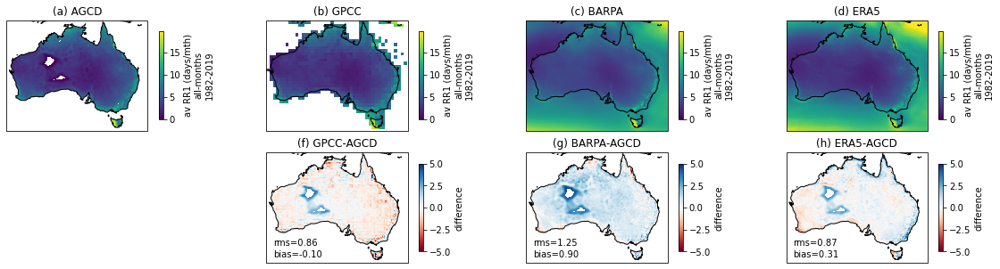

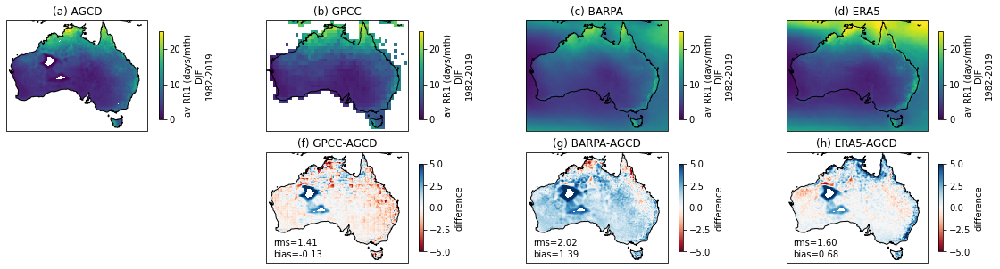

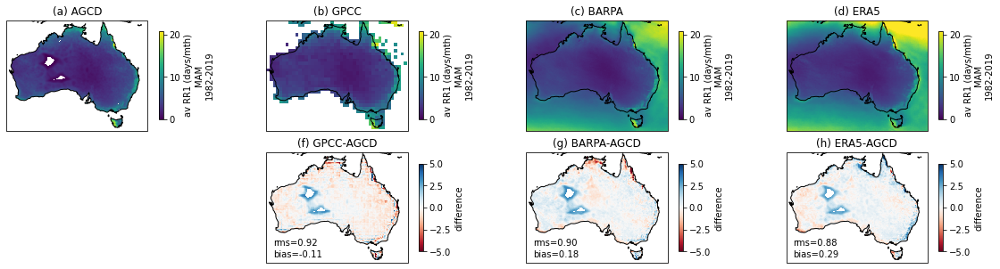

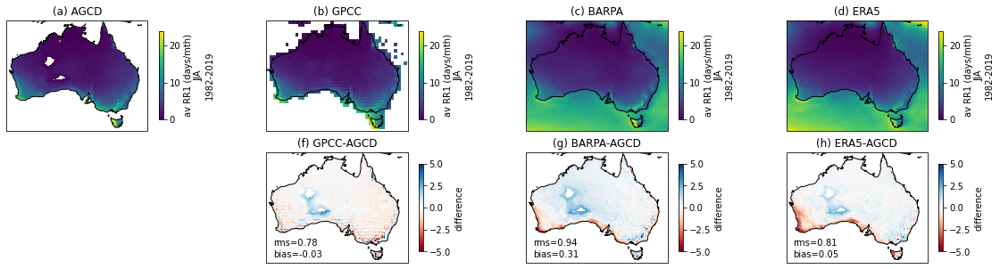

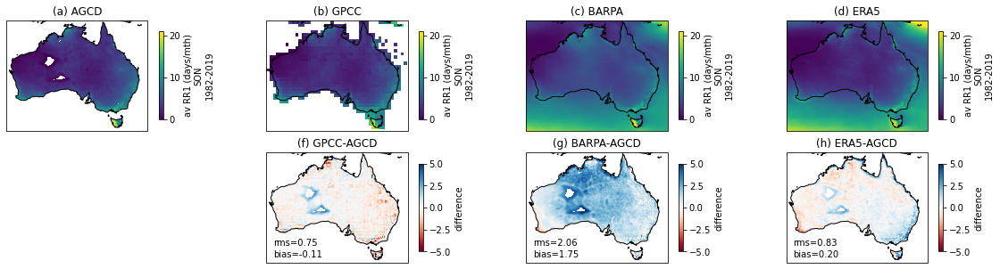

...

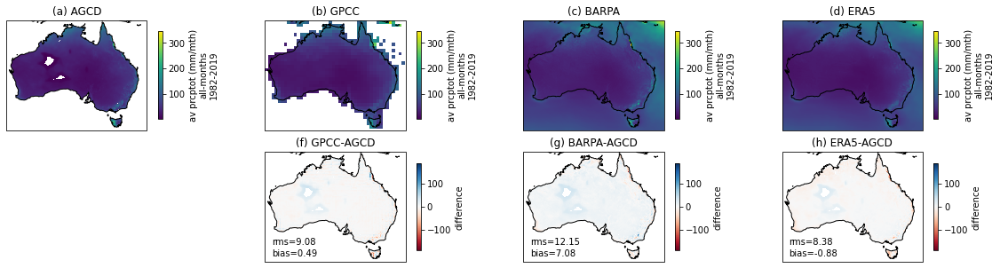

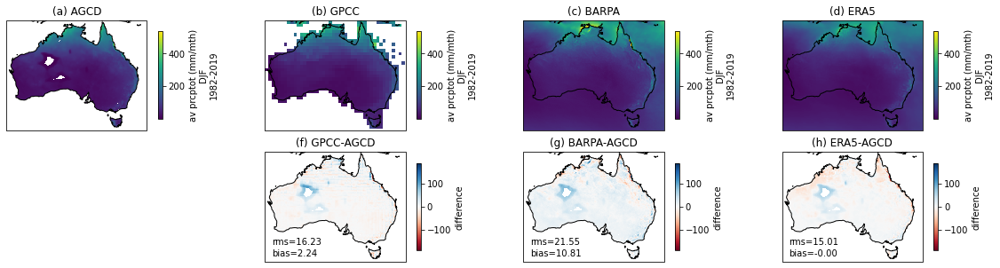

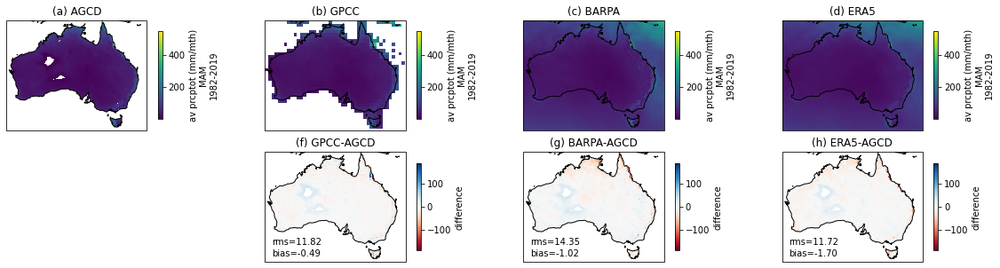

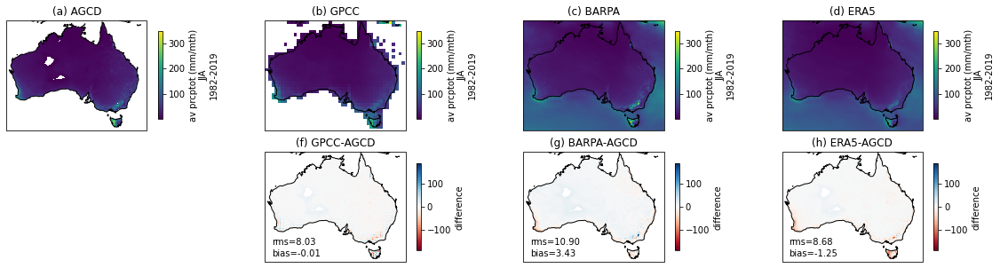

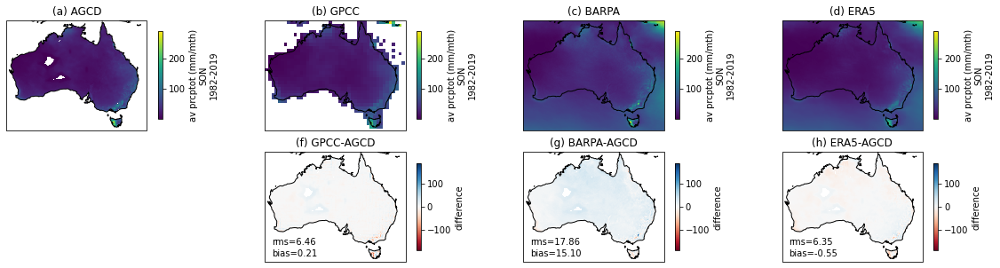

In [41]:
ref = "AGCD"
for metric_long in metrics.keys():
    print("DOING {:}".format(metric_long))
    metric = metric_long.split(":")[0]
    operation = metrics[metric_long]['operation']
    clabel = metrics[metric_long]['clabel'].format(metric=metric)
    dvmax = metrics[metric_long]['dvmax']
    wrapper()

### Next with GPCC as reference

Doing metric RR1
============ RR1 =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric dry_days
============ dry_days =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric R10mm
============ R10mm =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric R20mm
============ R20mm =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric RX1day
============ RX1day =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying max(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing MAM


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing JJA


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing SON


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Plotting...


/jobfs/58059115.gadi-pbs/ipykernel_122084/2065440300.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,5))


Doing metric RX5day
============ RX5day =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying max(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing MAM


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing JJA


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing SON


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Plotting...
Doing metric prcptot
============ prcptot =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
GPCC: Number of files: 38
AGCD: Number of files: 38
BARPA: Number of files: 38
ERA5: Number of files: 38
Unifying the domains across the data sources...
Doing for GPCC
Doing for ERA5
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...


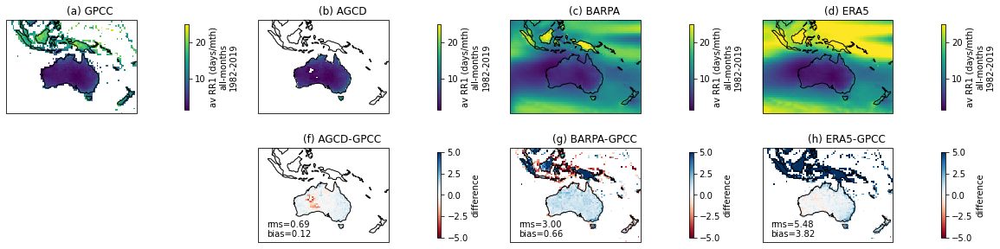

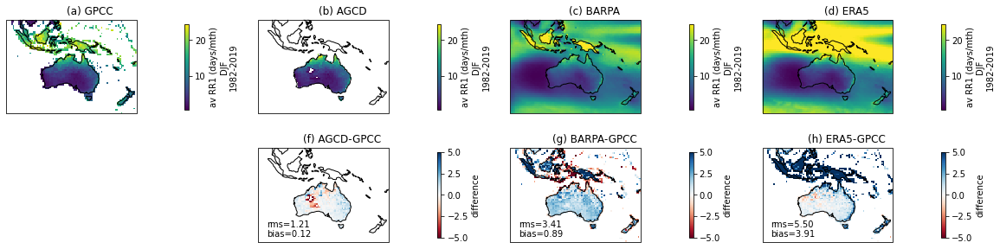

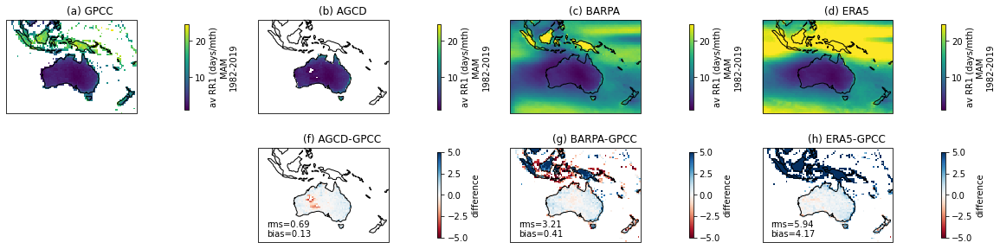

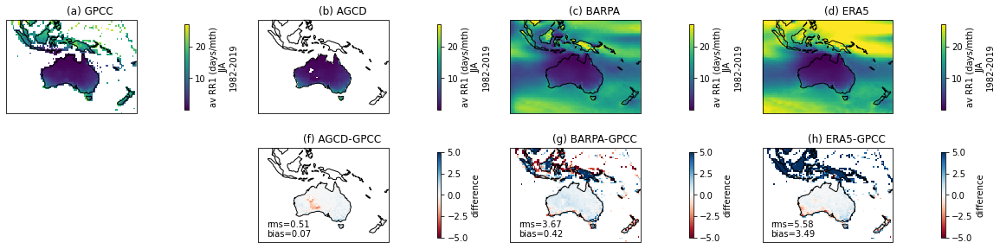

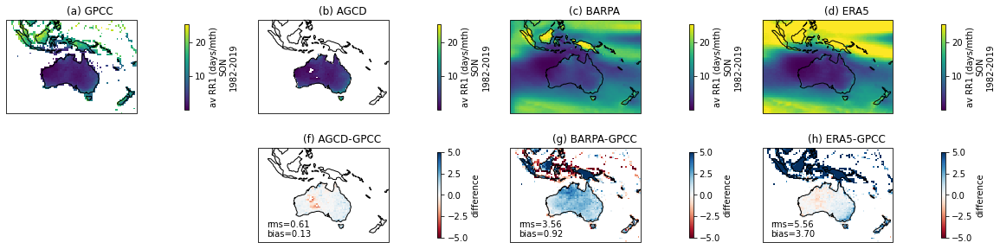

...

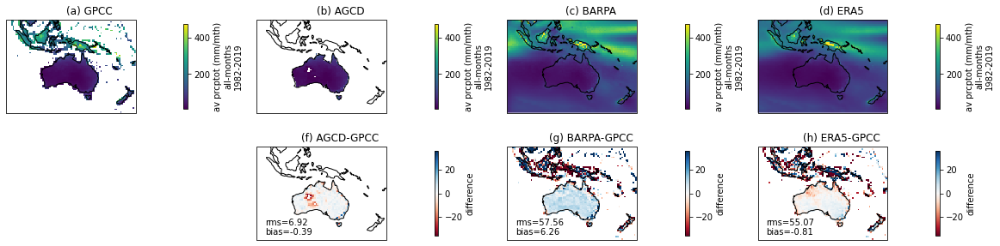

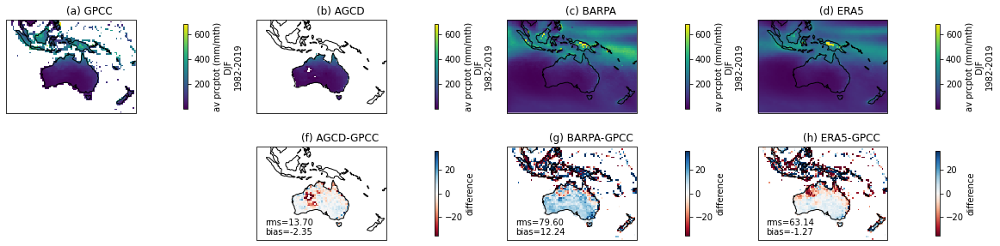

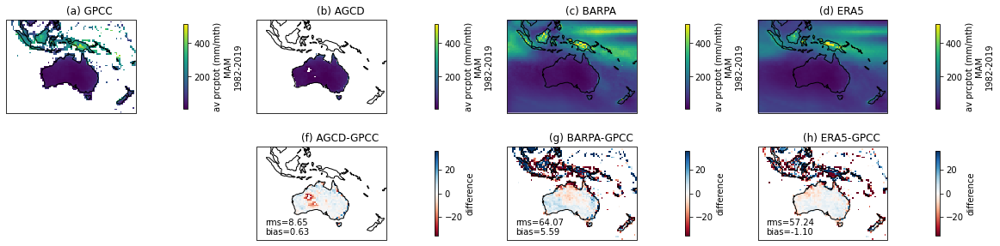

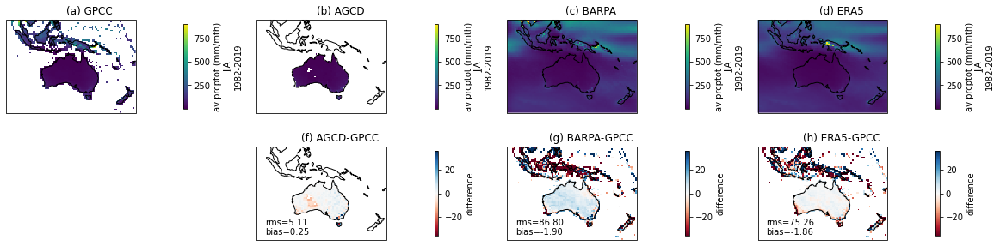

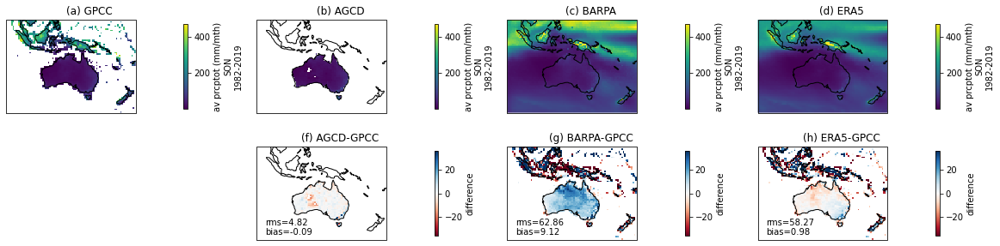

In [61]:
ref = "GPCC"
for metric_long in metrics.keys():
    print("DOING {:}".format(metric_long))
    metric = metric_long.split(":")[0]
    operation = metrics[metric_long]['operation']
    clabel = metrics[metric_long]['clabel'].format(metric=metric)
    dvmax = metrics[metric_long]['dvmax']
    wrapper()

### Finally with ERA5 as reference

Doing metric RR1
============ RR1 =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric dry_days
============ dry_days =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric R10mm
============ R10mm =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric R20mm
============ R20mm =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...
Doing metric RX1day
============ RX1day =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying max(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing DJF


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing MAM


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing JJA


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing SON


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Plotting...


/jobfs/58059115.gadi-pbs/ipykernel_122084/2065440300.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,5))


Doing metric RX5day
============ RX5day =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying max(dim='time') to the data and spatial interpolate...
Doing all-months


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing DJF


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing MAM


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing JJA


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Doing SON


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/dask/array/reductions.py:608: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


Plotting...
Doing metric prcptot
============ prcptot =============
Getting all the relevant files...
Reordering the data source names...
Checking the number of files...
ERA5: Number of files: 38
AGCD: Number of files: 38
GPCC: Number of files: 38
BARPA: Number of files: 38
Unifying the domains across the data sources...
Doing for ERA5


/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  return self.array[key]
/g/data/hh5/public/apps/miniconda3/envs/analysis3-22.04/lib/python3.9/site-packages/xarray/core/indexing.py:1228: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...   

Doing for GPCC
Applying mean(dim='time') to the data and spatial interpolate...
Doing all-months
Doing DJF
Doing MAM
Doing JJA
Doing SON
Plotting...


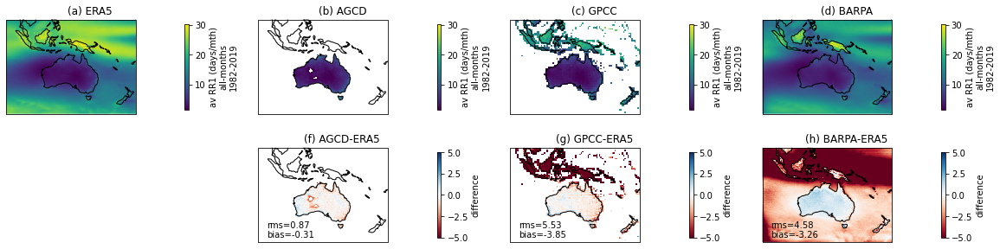

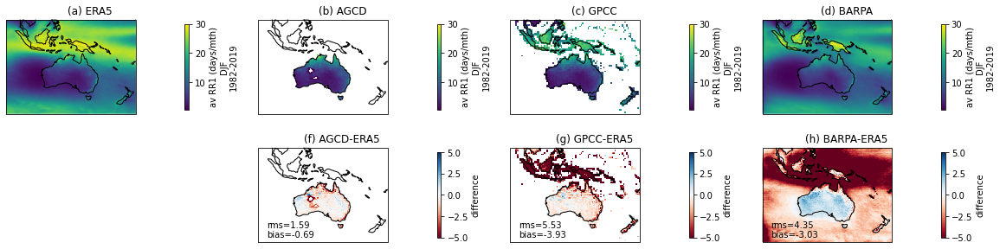

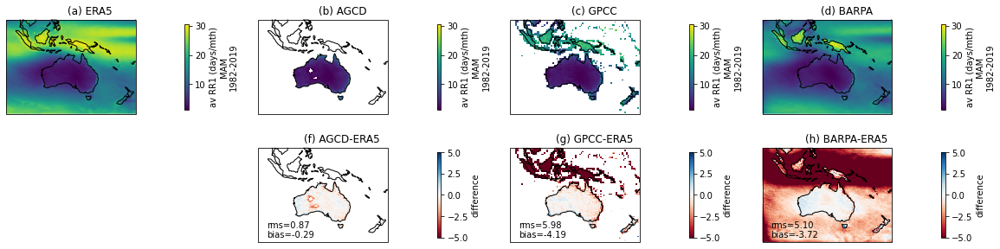

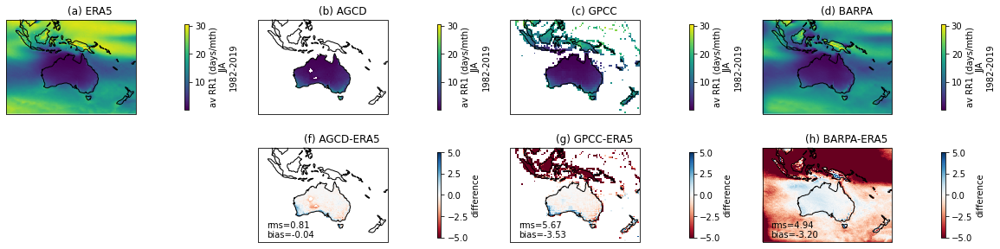

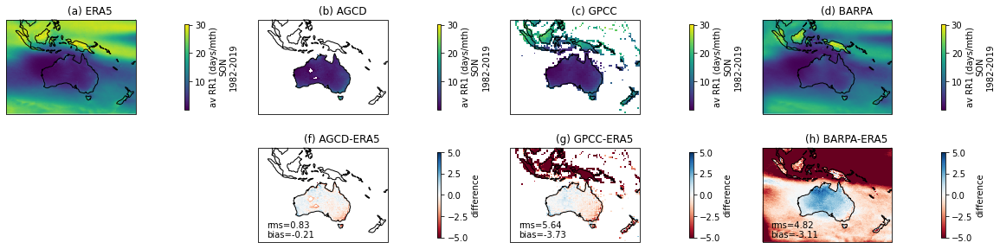

...

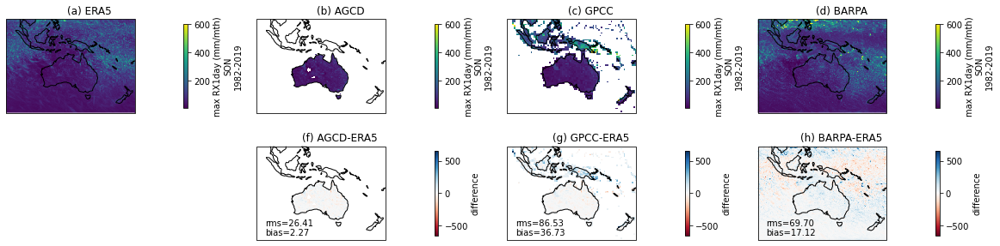

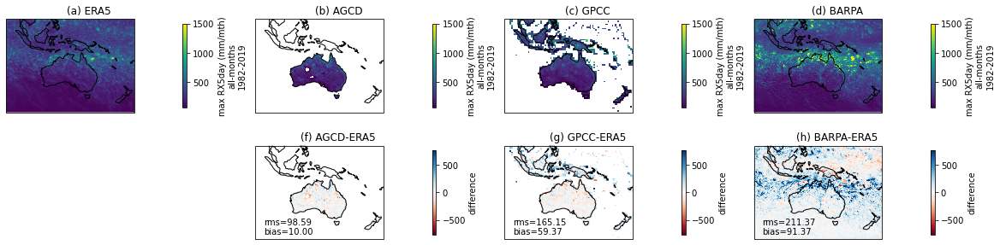

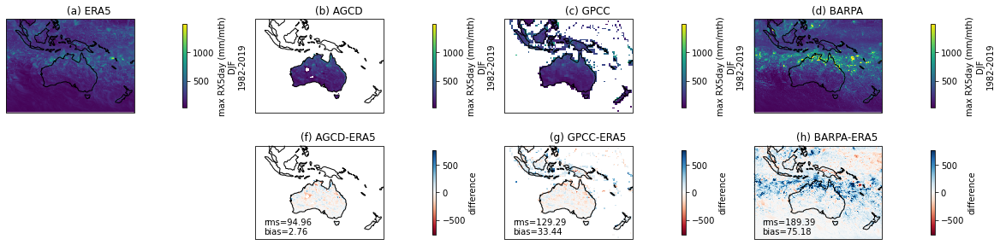

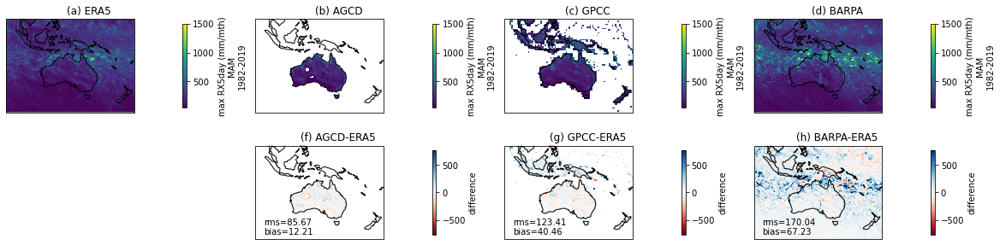

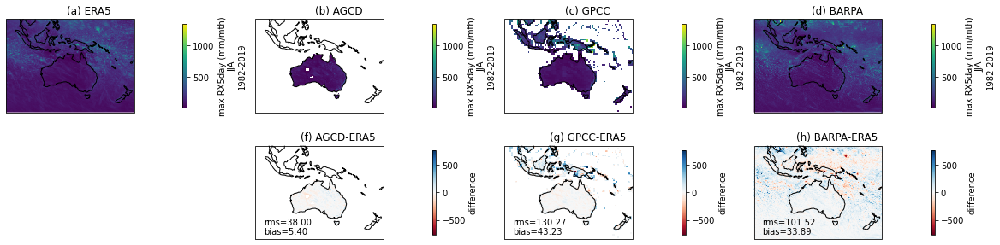

In [ ]:
ref = "ERA5"
for metric_long in metrics.keys():
    print("DOING {:}".format(metric_long))
    metric = metric_long.split(":")[0]
    operation = metrics[metric_long]['operation']
    clabel = metrics[metric_long]['clabel'].format(metric=metric)
    dvmax = metrics[metric_long]['dvmax']
    wrapper()